### Imports

In [1]:
%load_ext autoreload
%autoreload 1
%aimport code.generation
%aimport code.visualization
%aimport code.geometry
%aimport code.animations

import timeit

import numpy as np
import pandas as pd

import code.generation as gen
import code.visualization as vis
import code.geometry as geo
import code.animations as ani

### Points generation

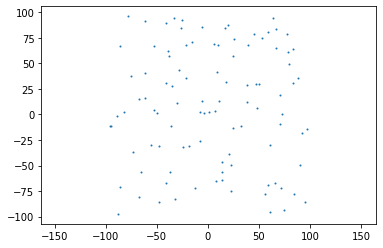

In [2]:
POINTS_A = gen.random_points_plane(100, np.array([-100, -100]), np.array([100, 100]))
POINTS_A_SMALL = gen.random_points_plane(50, np.array([-100, -100]), np.array([100, 100]))
vis.plot_points(POINTS_A, s=1)

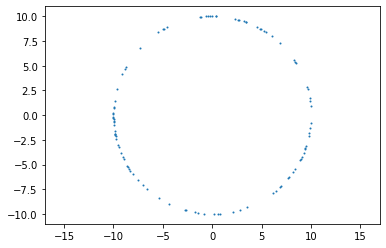

In [3]:
POINTS_B = gen.random_points_circle(100, 10, np.array([0, 0]))
POINTS_B_SMALL = gen.random_points_circle(30, 10, np.array([0, 0]))
vis.plot_points(POINTS_B, s=1)

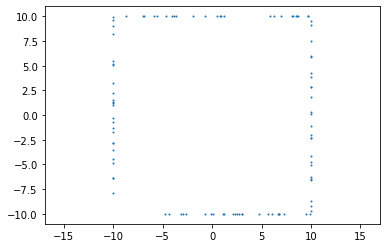

In [4]:
POINTS_C = gen.random_points_polygon(100, [np.array([-10, -10]), np.array([-10, 10]), np.array([10, 10]), np.array([10, -10])])
POINTS_C_SMALL = gen.random_points_polygon(50, [np.array([-10, -10]), np.array([-10, 10]), np.array([10, 10]), np.array([10, -10])])
vis.plot_points(POINTS_C, s=1)

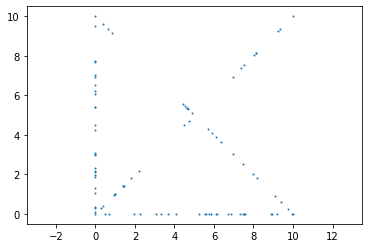

In [5]:
POINTS_D = gen.random_points_weird(25, 20, np.array([10, 0]), np.array([0, 0]), np.array([0, 10]), np.array([10, 10]))
POINTS_D_SMALL = gen.random_points_weird(10, 10, np.array([10, 0]), np.array([0, 0]), np.array([0, 10]), np.array([10, 10]))
vis.plot_points(POINTS_D, s=1)

### Graham's scan

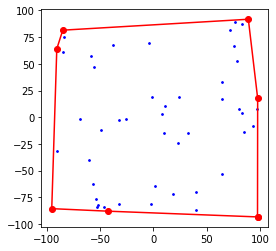

In [6]:
ani.ConvexHullAnimation(POINTS_A_SMALL, list(ani.graham_generator(POINTS_A_SMALL))).animation

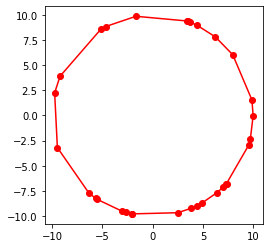

In [7]:
ani.ConvexHullAnimation(POINTS_B_SMALL, list(ani.graham_generator(POINTS_B_SMALL))).animation

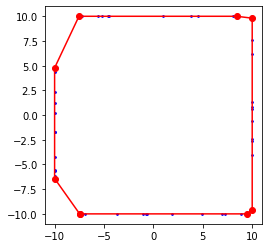

In [8]:
ani.ConvexHullAnimation(POINTS_C_SMALL, list(ani.graham_generator(POINTS_C_SMALL))).animation

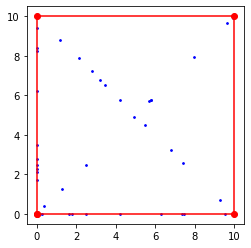

In [9]:
ani.ConvexHullAnimation(POINTS_D_SMALL, list(ani.graham_generator(POINTS_D_SMALL))).animation

### Jarvis march

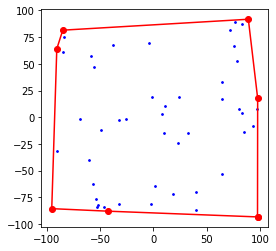

In [10]:
ani.ConvexHullAnimation(POINTS_A_SMALL, list(ani.jarvis_generator(POINTS_A_SMALL))).animation

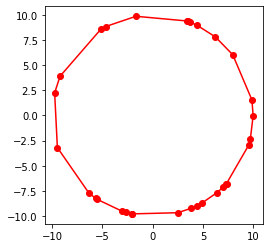

In [11]:
ani.ConvexHullAnimation(POINTS_B_SMALL, list(ani.jarvis_generator(POINTS_B_SMALL))).animation

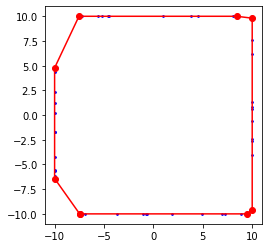

In [12]:
ani.ConvexHullAnimation(POINTS_C_SMALL, list(ani.jarvis_generator(POINTS_C_SMALL))).animation

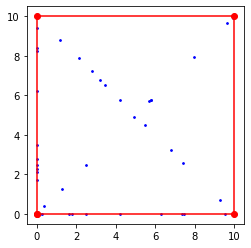

In [13]:
ani.ConvexHullAnimation(POINTS_D_SMALL, list(ani.jarvis_generator(POINTS_D_SMALL))).animation

### Comparision

In [14]:
datasets = [POINTS_A, POINTS_A_SMALL, POINTS_B, POINTS_B_SMALL, POINTS_C, POINTS_C_SMALL, POINTS_D, POINTS_D_SMALL]
datasets_names = ['big random', 'small random', 'big circle', 'small circle', 'big square', 'small square', 'big weird', 'small weird']
methods = [geo.graham, geo.jarvis]

In [15]:
results = dict()

results['points'] = [len(data) for data in datasets]

for method in methods:
    results[f'{method.__name__} hull'] = [len(list(method(data))) for data in datasets]
    results[f'{method.__name__} time'] = [timeit.timeit(lambda: method(data), number=100) for data in datasets]

In [16]:
pd.DataFrame(results, index=datasets_names)

,points,graham hull,graham time,jarvis hull,jarvis time
big random,100,11,0.155653,11,0.378018
small random,50,7,0.063376,7,0.123096
big circle,100,100,0.138283,100,3.514437
small circle,30,30,0.030373,30,0.342256
big square,100,8,0.149125,8,0.400555
small square,48,8,0.066326,8,0.176023
big weird,94,4,0.134336,4,0.177240
small weird,44,4,0.067971,4,0.082805
